In [1]:
import numpy as np
from time import time
import matplotlib.pyplot as plt
from scipy import signal
from matplotlib import animation
from IPython import display
import random
plt.rcParams['animation.embed_limit'] = 2**128
plt.rcParams["image.aspect"] = 'auto'
plt.rcParams['figure.max_open_warning'] = 2**128

### Exercise 5.3: 
- The goal of this exercise is to implement a Turing machine.

1. Read about Turing machines [at](http://thinkcomplex.com/tm).

2. Write a class called Turing that implements a Turing machine. For the action table, use the rules for a [3-state busy beaver](https://en.wikipedia.org/wiki/Turing_machine_examples#3-state_Busy_Beaver)

In [2]:
class MaquinaTuring:
    
    def __init__(self, n):
        """
        Creamos la maquina de Turing con su funcion 
        de transicion para 3 estados, 2 simbolos de 
        entrada busy beaver
        """
        self.n = n                                           
        self.reglas = self.funcion_transicion()                   #Tabla de estados
        self.estado = 'A'                                         #Estado inicial
        self.cinta = np.zeros((self.n, self.n), dtype=np.uint8)   #Se crea una matriz donde cada fila es la cinta en el paso i
        self.cabezal = self.n//2                                  #Se coloca el cabezal en el centro ya que se simula una cinta infinita a ambos lados
        self.siguiente = 1                                        #Se usa para el seguimiento
        
    def funcion_transicion(self):
        """
        Tabla de estados para 3 estados, 2 simbolos busy beaver
        """
        tabla_transicion = {}
        tabla_transicion[0, 'A'] = 1, 'R', 'B' 
        tabla_transicion[0, 'B'] = 1, 'L', 'A' 
        tabla_transicion[0, 'C'] = 1, 'L', 'B'
        tabla_transicion[1, 'A'] = 1, 'L', 'C' 
        tabla_transicion[1, 'B'] = 1, 'R', 'B' 
        tabla_transicion[1, 'C'] = 1, 'N', 'HALT'
        return tabla_transicion
    
    def operaciones(self):
        """
        Se simula la maquina con cada fila la misma cinta solo que en un paso de tiempo distinto de la
        siguente manera copiamos el contenido anterior de la cinta en la nueva fila y dado el simbolo leido
        en la fila anterior por el cabezal y el estado anterior se escribe en la cinta el nuevo simbolo 
        se cambia de estado y se mueve el cabezal en la cinta actual
        """
        #print(self.cinta)
        if self.estado != 'HALT':
            i = self.siguiente                                     #Siguiente fila a modificar
            self.cinta[i] = self.cinta[i-1]                        #copiamos el contenido de la fila anterior en la nueva fila
            simbolo_leido = self.cinta[i-1, self.cabezal-1]        #de la fila i-1 en la columna de en medio esta el símbolo que leyo el cabezal
            print("Simbolo leido", simbolo_leido)
            print("Estado anterior", self.estado)
            simbolo_escrito, direccion, self.estado = self.reglas[simbolo_leido, self.estado] #Obtenemos el símbolo, dirección y estado de acuerdo a la tabla de transición
            print("Simbolo escrito:", simbolo_escrito)
            print( "Moviento Cabezal:", direccion)
            print("Estado Actual:", self.estado)
            #print(self.siguiente)
            print('\n')
            
            self.cinta[i, self.cabezal-1] = simbolo_escrito      #Escribimos el símbolo de la transición dada(si uno observa solo se escriben unos) 
            if direccion == 'R':                                 
                self.cabezal += 1                                #Movemos el cabezal a la derecha 
            elif direccion == 'L':
                self.cabezal -= 1                                #Movemos el cabezal a la izquierda
            else:
                self.cabezal = self.cabezal                      #No movemos el cabezal
            self.siguiente += 1                                  #Movemos a la siguiente fila
        else:
            return
        
    """Me guie en la "compresed" run con solo los estados y siempre va a terminar despues de 13 pasos
    y despues de haber escrito 6 unos en la cinta(Aunque no entendi como mueven el cabezal o la cinta en la pagina de Wikipedia)"""
    def correr_maquina(self):
        print('La cinta inicialmente ', self.cinta[self.siguiente-1])
        print("Con el cabezal en la posicion", self.cabezal-1)
        print("\n")
        for i in range(13):
            self.operaciones()                                                       #Se hace las operaciones correspondientes
            print("La configuracion actual de la cinta",self.cinta[self.siguiente-1])
            print("Con el cabezal en la posicion ", self.cabezal-1)
            print('\n')

In [3]:
Maquina = MaquinaTuring(14) #Si es menor a 14 causa error
Maquina.correr_maquina()

La cinta inicialmente  [0 0 0 0 0 0 0 0 0 0 0 0 0 0]
Con el cabezal en la posicion 6


Simbolo leido 0
Estado anterior A
Simbolo escrito: 1
Moviento Cabezal: R
Estado Actual: B


La configuracion actual de la cinta [0 0 0 0 0 0 1 0 0 0 0 0 0 0]
Con el cabezal en la posicion  7


Simbolo leido 0
Estado anterior B
Simbolo escrito: 1
Moviento Cabezal: L
Estado Actual: A


La configuracion actual de la cinta [0 0 0 0 0 0 1 1 0 0 0 0 0 0]
Con el cabezal en la posicion  6


Simbolo leido 1
Estado anterior A
Simbolo escrito: 1
Moviento Cabezal: L
Estado Actual: C


La configuracion actual de la cinta [0 0 0 0 0 0 1 1 0 0 0 0 0 0]
Con el cabezal en la posicion  5


Simbolo leido 0
Estado anterior C
Simbolo escrito: 1
Moviento Cabezal: L
Estado Actual: B


La configuracion actual de la cinta [0 0 0 0 0 1 1 1 0 0 0 0 0 0]
Con el cabezal en la posicion  4


Simbolo leido 0
Estado anterior B
Simbolo escrito: 1
Moviento Cabezal: L
Estado Actual: A


La configuracion actual de la cinta [0 0 0 0 1 1 

3. Write a class named TuringViewer that generates an image that represents the state of the tape and the position and state of the head. For one example of what that might look like, [see](http://thinkcomplex.com/turing).

In [4]:
# Solution

from matplotlib.patches import RegularPolygon

class TuringViewer:
    
    def __init__(self, n):
        """
        Creamos la maquina de Turing con su funcion 
        de transicion para 3 estados, 2 simbolos de 
        entrada busy beaver
        """
        self.n = n                                           
        self.reglas = self.funcion_transicion()                 #Tabla de estados
        self.estado = 'A'                                       #Estado inicial
        self.cinta = np.zeros((self.n, self.n), dtype=np.uint8) #Se crea una matriz donde cada fila es la cinta en el paso i
        self.cabezal = self.n//2                                #Se coloca el cabezal en el centro ya que se simula una cinta infinita a ambos lados
        self.siguiente = 1                                      #Se usa para el seguimiento
        self.r = 0                                              
        self.fig, self.imagenB = self.figura()                  #SE crea la imagen
        
    def funcion_transicion(self):
        """
        Tabla de estados para 3 estados, 2 simbolos busy beaver
        """
        tabla_transicion = {}
        tabla_transicion[0, 'A'] = 1, 'R', 'B' 
        tabla_transicion[0, 'B'] = 1, 'L', 'A' 
        tabla_transicion[0, 'C'] = 1, 'L', 'B'
        tabla_transicion[1, 'A'] = 1, 'L', 'C' 
        tabla_transicion[1, 'B'] = 1, 'R', 'B' 
        tabla_transicion[1, 'C'] = 1, 'N', 'HALT'
        return tabla_transicion
    
    def operaciones(self):
        """
        Se simula la maquina con cada fila la misma cinta solo que en un paso de tiempo distinto de la
        siguente manera copiamos el contenido anterior de la cinta en la nueva fila y dado el simbolo leido
        en la fila anterior por el cabezal y el estado anterior se escribe en la cinta el nuevo simbolo 
        se cambia de estado y se mueve el cabezal en la cinta actual
        """
        if self.estado != 'HALT':
            i = self.siguiente                                     #Siguiente fila a modificar
            self.cinta[i] = self.cinta[i-1]                        #copiamos el contenido de la fila anterior en la nueva fila
            simbolo_leido = self.cinta[i-1, self.cabezal-1]        #de la fila i-1 en la columna de en medio esta el simbolo que leyo el cabezal
            simbolo_escrito, direccion, self.estado = self.reglas[simbolo_leido, self.estado]
            
            self.cinta[i, self.cabezal-1] = simbolo_escrito      #Escribimos el simbolo de la transicion dada(si uno observa solo se escriben unos) 
            if direccion == 'R':                                 
                self.cabezal += 1                                #Movemos el cabezal a la derecha 
            elif direccion == 'L':
                self.cabezal -= 1                                #Movemos el cabezal a la izquierda
            else:
                self.cabezal = self.cabezal                      #No movemos el cabezal
            self.siguiente += 1                                  #Movemos a la siguiente fila
        else:
            return
        
    def correr(self):
        self.operaciones()
        self.imagenB.set_array(self.cinta)
        
    def figura(self):
        fig, ax = plt.subplots(figsize=(5,5))
        ax.set_axis_off()
        imagenB = ax.imshow(self.cinta, cmap='binary', alpha=1, vmin=0, vmax=1) #Creamos la imagen de la cinta
        return fig, imagenB
    
    def cabeza(self, i):
        if i < 0:
            return 
        if i == 0 and self.r == 0:                                                #Esto lo hice ya que siempre que entra a este bucle hay 2 ceros no se porque
            xy = np.array([self.cabezal-1, i])                                    #Localizamos el cabezal
            arrow = RegularPolygon(tuple(xy), 3, 0.3, orientation=1, color='gray')#Esto lo saque de la respuesta del notebook del libro del ejercicio de la hormiga para dibujar el cabezal
            ax = plt.gca()                                                        #Creamos los ejes para la figura
            ax.add_patch(arrow)                                                   #Insertamos el cabezal
            self.r+=1
        else:
            xy = np.array([self.cabezal-1, i])                                    #Localizamos el cabezal 
            self.correr()                                                         #Corremos la cinta
            #print(xy)                  
            arrow = RegularPolygon(tuple(xy), 3, 0.3, orientation=1, color='gray')#Esto lo saque de la respuesta del notebook del libro del ejercicio de la hormiga para dibujar el cabezal
            ax = plt.gca()                                                        #Creamos los ejes para la figura
            ax.add_patch(arrow)                                                   #Insertamos el cabezal
            #print(self.cinta)
    
    def dibujar(self):
        # crear figura
        anim = animation.FuncAnimation(self.fig, self.cabeza, frames=14)
        return display.display_html(anim.to_jshtml(), raw=True)

Once 
 
 Loop 
 
 Reflect

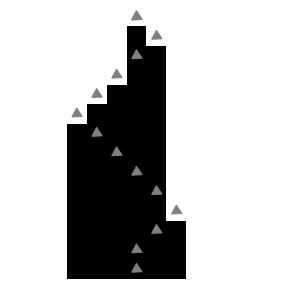

In [6]:
TuringView = TuringViewer(14)
TuringView.dibujar()

### Exercise 6.5:
- If you generalize the Turing machine to two dimensions, or add a read-write head to a 2-D CA, the result is a cellular automaton called a [Turmite](https://en.wikipedia.org/wiki/Turmite). It is named after a termite because of the way the read-write head moves, but spelled wrong as an homage to Alan Turing. The most famous Turmite is Langton’s Ant, discovered by Chris Langton in 1986. [See](http://thinkcomplex.com/langton).

- The ant is a read-write head with four states, which you can think of as facing north, south, east or west. The cells have two states, black(1) and white(0). 
- The rules are simple. During each time step, the ant checks the color of the cell it is on. If black, the ant turns to the right, changes the cell to white, and moves forward one space. If the cell is white, the ant turns left, changes the cell to black, and moves forward.
- Given a simple world, a simple set of rules, and only one moving part, you might expect to see simple behavior but you should know better by now.
- Starting with all white cells, Langton’s ant moves in a seemingly random pattern for more than 10,000 steps before it enters a cycle with a period of 104 steps. After each cycle, the ant is translated diagonally, so it leaves a trail called the “highway”.

- Write an implementation of Langton’s Ant.

In [7]:
class LangtonsAnt:

    def __init__(self, n):
        """Vamos a implentar la LangstonAnt de la siguiente forma
        se crea una matriz de ceros se coloca la hormiga en el centro de esta matriz
        se le da una orientacion aleatoria y se dan las reglas"""
        self.matriz = np.zeros((n, n), np.uint8)           #Se crea una cuadricula con todas su celdas en blanco(0)
        self.hormiga = np.array([n//2, n//2])              #Localicacion inicial de la hormiga
        self.color = 0                                     #Ya que todas las celdas estan en blanco el color inicial es 0
        self.orientacion = random.choice(['N','S','E','O'])#Estado inicial
        self.transicion = self.tabla()                     #Tabla de transiciones
        self.fig, self.imagen = self.figura()              #Creamos la fSigura de la matriz
    
    def tabla(self):
        """Transiciones"""
        tabla_transicion = {}
        tabla_transicion[0] = 'L', 1
        tabla_transicion[1] = 'R', 0
        return tabla_transicion
    
    def movimientos(self, movimiento):
        """De acuerdo al movimiento dado por la tabla y la orientación anterior de la hormiga 
        se mueve la orientación y posición de la hormiga """
        if movimiento=='L':                                                 #Si se mueve a la izquierda
            if self.orientacion=='N':                                       #Y su orientación anterior es norte
                self.orientacion = 'O'                                      #Se cambia la orientacion a oeste
                self.hormiga = np.array([self.hormiga[0],self.hormiga[1]-1])#Se mueve la hormiga a la izquierda
            elif self.orientacion=='S':                                     #Y su orientación es sur
                self.orientacion = 'E'                                      #Se cambia la orientacion a este
                self.hormiga = np.array([self.hormiga[0],self.hormiga[1]+1])#Se mueve la hormiga a la derecha
            elif self.orientacion=='E':                                     #Y su orientación es este
                self.orientacion = 'N'                                      #Se cambia la orientacion a norte
                self.hormiga = np.array([self.hormiga[0]-1,self.hormiga[1]])#Se mueve la hormiga hacia abajo
            elif self.orientacion=='O':                                     #Y su orientación es oeste
                self.orientacion = 'S'                                      #Se cambia la orientacion a sur
                self.hormiga = np.array([self.hormiga[0]+1,self.hormiga[1]])#Se mueve la hormiga hacia arriba
        elif movimiento=='R':                                               #Si se mueve a la derecha
            if self.orientacion=='N':                                       #Y su orientación es norte
                self.orientacion = 'E'                                      #Se cambia la orientacion a este
                self.hormiga = np.array([self.hormiga[0],self.hormiga[1]+1])#Se mueve la hormiga a la derecha
            elif self.orientacion=='S':                                     #Y su orientación es sur
                self.orientacion = 'O'                                      #Se cambia la orientacion a oeste
                self.hormiga = np.array([self.hormiga[0],self.hormiga[1]-1])#Se mueve la hormiga a la izquierda
            elif self.orientacion=='E':                                     #Y su orientación es este
                self.orientacion = 'S'                                      #Se cambia la orientacion a sur
                self.hormiga = np.array([self.hormiga[0]+1,self.hormiga[1]])#Se mueve la hormiga hacia abajo
            elif self.orientacion=='O':                                     #Y su orientación es oeste
                self.orientacion = 'N'                                      #Se cambia la orientacion a norte
                self.hormiga = np.array([self.hormiga[0]-1,self.hormiga[1]])#Se mueve la hormiga hacia arriba
        return self.orientacion, self.hormiga
    
    def regla(self):
        """ Se obtiene el color de la celda en la cual se encuenta actualmente la hormiga,
        de acuerdo a la tabla se cambia el color y se mueve la orientación y posición de la hormiga"""
        color = self.matriz[tuple(self.hormiga)]                      #Se obtiene el color de la celda en la que esta la hormiga
        movimiento, self.color= self.transicion[color]                #Se obtiene el movimiento a hacer y el color a colorear la celda actual
        self.matriz[tuple(self.hormiga)] = self.color                 #Se colorea la celda actual
        self.orientacion, self.hormiga = self.movimientos(movimiento) #Se mueve la hormiga de acuerdo a su orientación
        
    def animacion(self, i):
        if i < 0:
            return 
        self.regla()                                                 #Se corre un paso de él autómata
        self.imagen.set_array(self.matriz)                           #Se crea la imagen para la matriz
        
    def figura(self):
        fig, ax = plt.subplots(figsize=(4,4))
        ax.set_axis_off()
        imagen = ax.imshow(self.matriz, cmap='binary', alpha=1, vmin=0, vmax=1) #Generamos la imagen
        return fig, imagen
        
    def dibujar(self):
        # crear figura
        anim = animation.FuncAnimation(self.fig, self.animacion, frames=13000, interval=1000/12) #Creamos la animación
        return display.display_html(anim.to_jshtml(), raw=True)

Once 
 
 Loop 
 
 Reflect

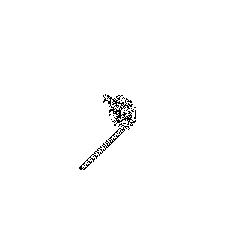

In [8]:
start_time = time()
Langston = LangtonsAnt(300)
Langston.dibujar()
elapsed_time = time() - start_time

In [9]:
print("Tiempo de ejecucion: %.1i minutos." % (elapsed_time//60))

Tiempo de ejecucion: 5 minutos.


### Exercise 7.2:
- In 1990 Bak, Chen and Tang proposed a cellular automaton that is an abstract [model of a forest fire.](https://en.wikipedia.org/wiki/Forest-fire_model) Each cell is in one of three states: empty, occupied by a tree, or on fire.

The rules of the CA are:
1. An empty cell becomes occupied with probability p.
2. A cell with a tree burns if any of its neighbors is on fire.
3. A cell with a tree spontaneously burns, with probability f , even if none of its neighbors is on fire.
4. A cell with a burning tree becomes an empty cell in the next time step.

- Write a program that implements this model. You might want to inherit from Cell2D. Typical values for the parameters are p = 0.01 and f = 0.001, but you might want to experiment with other values.

In [10]:
class BosqueLlamas:
    
    def __init__(self, n, p, f):
        """Creamos el automata dados el tamaño del mismo y sus probabilidades
        p de colocar un arbol y f de que un arbol se queme espontaneamente"""
        self.n = n                                                       #Tamaño cuadricula            
        self.p = p                                                       #Probabilidad de que aparezca un arbol                                
        self.f = f                                                       #Probabilidad de que se queme un arbol
        self.A = (np.random.random(size = (self.n, self.n)) <= self.p).astype(np.int_)  #Se crea la matriz donde en cada celda hay un arbol(1) o esta vacia(0)
        self.w = np.array([
                  [0, 1, 0],
                  [1, 0, 1],
                  [0, 1, 0]
                ])
        self.fig, self.imagen = self.figura()
    
    
    def paso_fuego(self):
        c = signal.correlate2d(self.A, self.w, mode='same', boundary='wrap') 
        t = np.random.random(self.A.shape)                                   #Se crea una matriz que le asigna un numero entre[0,1] a cada celda
        nuevo_arbol = (self.A==0) & (t<self.p)                               #Se coloca un arbol si la celda esta vacia con probabilidad p
        fuego = (self.A==1) & ((c>=5) | (t<self.f))                          #Se crea un fuego si la celda contiene un arbol y algun vecino esta incendiado o la probabilidad de esta celda es menor a f
        self.A[self.A==5] = 0                                                #Si estaba en fuego se vacia
        self.A[nuevo_arbol] = 1                                              #Se colocan los nuevos arboles
        self.A[fuego] = 5                                                    #Se inciendian los arboles
        
    def animacion(self, i):
        if i < 0:
            return 
        self.paso_fuego()                                                    #Hacemos un paso
        self.imagen.set_array(self.A)                                        #Creamos la imagen para el arreglo
        
    def num_arboles(self, i=None):
        a = self.A[:i,:i] 
        return np.sum(a==1)                                                  #Contamos el numero de arboles en la cuadricula dada
    
    def figura(self):
        fig, ax = plt.subplots(figsize=(4,4))
        ax.set_axis_off()
        imagen = ax.imshow(self.A, cmap='hot', alpha=1, vmin=0, vmax=5)     #Generamos la imagen
        return fig, imagen
    
    def dibujar(self):
        # crear figura
        anim = animation.FuncAnimation(self.fig, self.animacion, frames=500, interval=1000/24) #Creamos la animación
        return display.display_html(anim.to_jshtml(), raw=True)

Once 
 
 Loop 
 
 Reflect

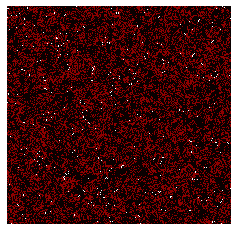

In [11]:
start_time = time()
#bosque = BosqueLlamas(400, p=0.003, f=0.00005)
#bosque = BosqueLlamas(400, p=0.6, f=0.1)
#bosque = BosqueLlamas(400, p=0.9 , f=0.05)
#bosque = BosqueLlamas(400, p=0.8 , f=0.5)
#bosque = BosqueLlamas(400, p=0.9 , f=0.9)
bosque = BosqueLlamas(400, p=0.01, f=0.001)
bosque.dibujar()
elapsed_time = time() - start_time

In [12]:
print("Tiempo de ejecucion: %.5f segundos." % elapsed_time)

Tiempo de ejecucion: 48.40099 segundos.


- Starting from a random initial condition, run the model until it reaches a steady state where the number of trees no longer increases or decreases consistently.

- In steady state, is the geometry of the forest fractal? What is its fractal dimension?

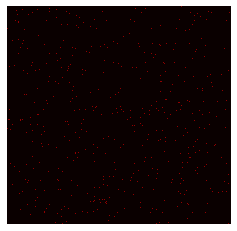

In [13]:
bosque = BosqueLlamas(400, p=0.01, f=0.001)

In [14]:
def genera_simulacion(a, b):

    T = []
    n = [i for i in range(a, b)]

    for i in n:
        for j in range(1, a+1):
            bosque.paso_fuego()
            num = bosque.num_arboles(i)
            T.append(num)
    return T

In [ ]:
a, b = 20, 399

start_time = time()
T = genera_simulacion(a, b)
elapsed_time = time() - start_time

In [ ]:
print("Tiempo de ejecucion: %i minutos." % (elapsed_time/60))

In [ ]:
fig, ax = plt.subplots(figsize = (10,10))
T = np.array(T)
ax.plot([i for i in range(a, b) for j in range(1, a+1)], T, ".", color='g', label='Arboles')

x = [i for i in range(a, b) for j in range(0, a)]
x = np.array(x)

ax.plot(x, x, label='dim1', color='r')
ax.plot(x, x**2, label='dim2', color='b')

polinomio = np.polyfit(np.log(x), np.log(T), deg=1)
regresion = np.exp(np.polyval(polinomio, np.log(x)))

ax.plot(x, regresion, label="regresion", color='k')

ax.set_xscale("log")
ax.set_yscale("log")
ax.legend()